<a href="https://colab.research.google.com/github/omkarnaik713/my_projects/blob/main/Diabetes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
dataset = pd.read_csv('diabetes.csv')
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253680 entries, 0 to 253679
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Diabetes_012          253680 non-null  float64
 1   HighBP                253680 non-null  float64
 2   HighChol              253680 non-null  float64
 3   CholCheck             253680 non-null  float64
 4   BMI                   253680 non-null  float64
 5   Smoker                253680 non-null  float64
 6   Stroke                253680 non-null  float64
 7   HeartDiseaseorAttack  253680 non-null  float64
 8   PhysActivity          253680 non-null  float64
 9   Fruits                253680 non-null  float64
 10  Veggies               253680 non-null  float64
 11  HvyAlcoholConsump     253680 non-null  float64
 12  AnyHealthcare         253680 non-null  float64
 13  NoDocbcCost           253680 non-null  float64
 14  GenHlth               253680 non-null  float64
 15  

In [ ]:
dataset.isnull().sum()

Diabetes_012            0
HighBP                  0
HighChol                0
CholCheck               0
BMI                     0
Smoker                  0
Stroke                  0
HeartDiseaseorAttack    0
PhysActivity            0
Fruits                  0
Veggies                 0
HvyAlcoholConsump       0
AnyHealthcare           0
NoDocbcCost             0
GenHlth                 0
MentHlth                0
PhysHlth                0
DiffWalk                0
Sex                     0
Age                     0
Education               0
Income                  0
dtype: int64

There are no null values present in the dataset.



---

**Removing the Duplicated Values**


In [ ]:
dataset.duplicated().sum()

23899

In [ ]:
dataset.drop_duplicates(inplace = True)

In [ ]:
columns = []
for col in dataset.columns :
  columns.append(col)

**Plotting Outliers**

<Axes: >

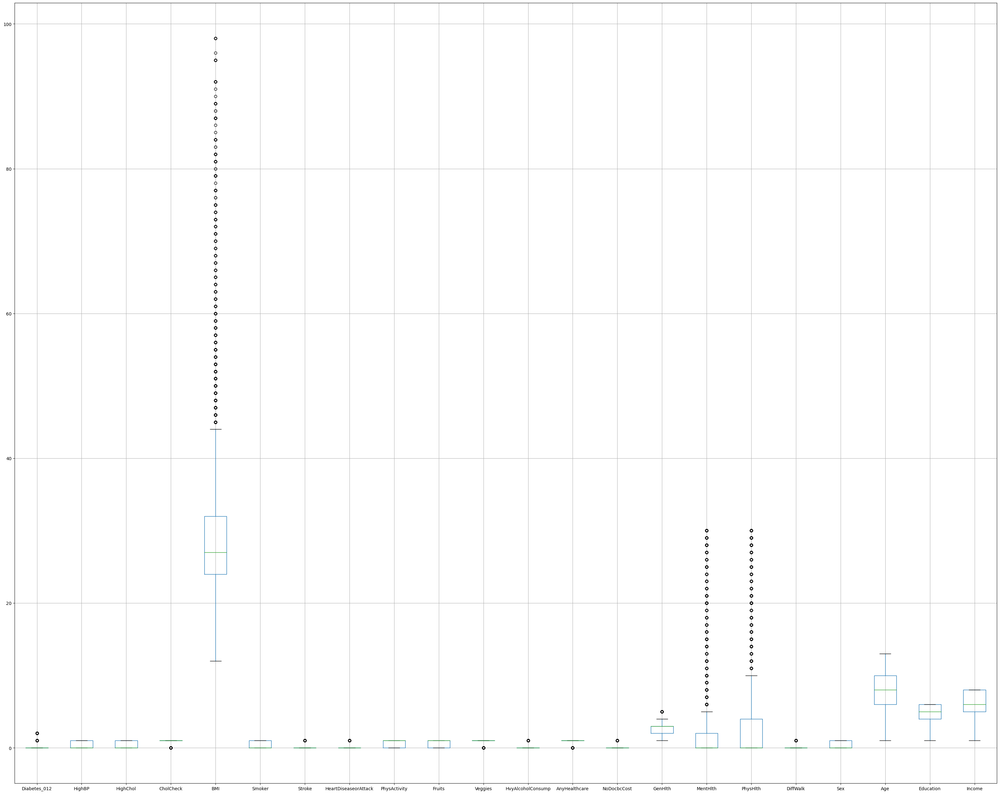

In [ ]:
dataset.boxplot(columns,figsize = (40,32))

In [ ]:
len(dataset)

229781



---



---
Plotting the outliers graphs for each features with respect to the target value.


In [ ]:
import plotly.express as px
fig = px.box(dataset,x = 'Diabetes_012',y = 'HighBP',title = 'Distribution of HighBP')
fig.show()

In [ ]:
columns =[]
for col in dataset.columns :
  columns.append(col)

for i in range(len(columns)):
  fig = px.box(dataset, x = 'Diabetes_012', y = columns[i])
  fig.show()

In [ ]:
dataset.reset_index(inplace = True)
outliers = []
dataset.drop('index', axis = 1, inplace = True)
column_list_outliers = ['CholCheck','BMI','Stroke','HeartDiseaseorAttack','Veggies','HvyAlcoholConsump','AnyHealthcare','NoDocbcCost','MentHlth','PhysHlth']
for col in column_list_outliers :
  q1 = dataset[col].quantile(0.25)
  q3 = dataset[col].quantile(0.75)
  iqr = q3-q1
  high = q3 + 1.5 * iqr
  low = q1 - 1.5 * iqr
  values = dataset[col]
  for val in values :
    if val < low or val > high:
      outliers.append(val)

As we can see outliers are stored in the above array. The reason for not removing the outliers is that the abnormal conditions of patients are also important as they give more information on the affect of that specific feature on the outcome prediction.

Visualization

<Axes: xlabel='Diabetes_012', ylabel='count'>

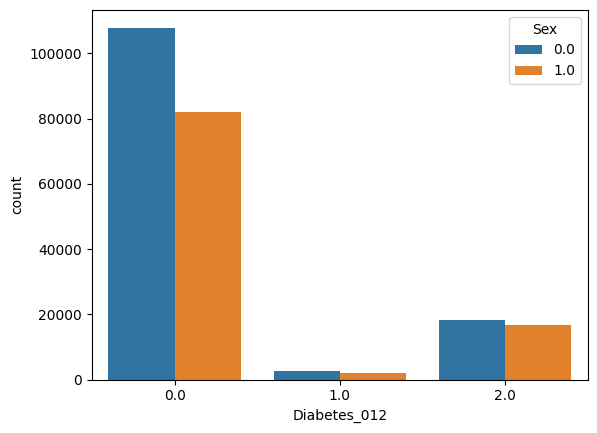

In [ ]:
import seaborn as sns
sns.countplot(dataset, x = 'Diabetes_012', hue = 'Sex')

In [ ]:
len(dataset)

229781

<Axes: xlabel='Diabetes_012', ylabel='count'>

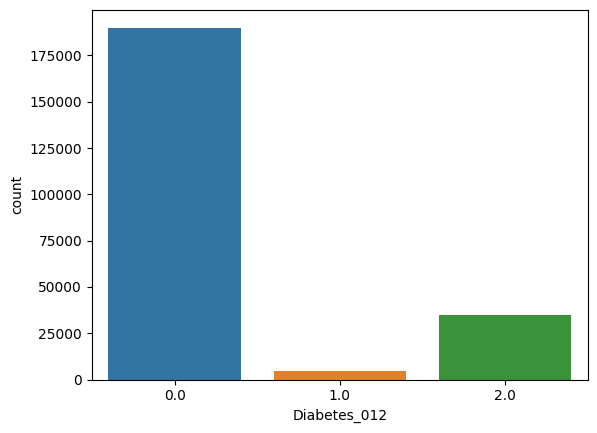

In [ ]:
import seaborn as sns
sns.countplot(dataset,x = 'Diabetes_012')

The dataset is imbalanced therefore we need to perform sampling techniques



---



---

We weiil be using two Sampling technique:
1. RandomOverSampler
2. SMOTE


In [ ]:
x = dataset.drop('Diabetes_012',axis = 1)
y = dataset['Diabetes_012']
from imblearn.over_sampling import SMOTE,RandomOverSampler
smote = SMOTE()
ros = RandomOverSampler()
x_ros,y_ros = ros.fit_resample(x,y)
x_sm,y_sm = smote.fit_resample(x,y)

In [ ]:
data = x_sm.copy()
data['Diabetes_012']= y_sm

In [ ]:
data = x_sm.copy()
data['Diabetes_012'] = y_sm
data_ros = x_ros.copy()
data_ros['Diabetes_012'] = y_ros

In [ ]:
import seaborn as sns

<Axes: xlabel='Diabetes_012', ylabel='count'>

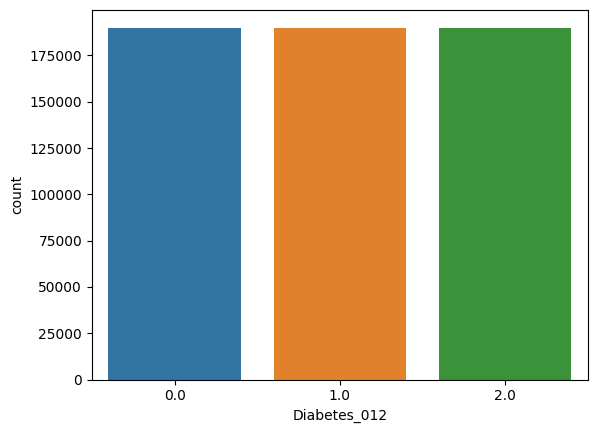

In [ ]:
sns.countplot(data_ros,x = 'Diabetes_012')

In [ ]:
# how many duplicate copies are present in both of the dataset
print(data.duplicated().sum())
print(data_ros.duplicated().sum())
data.drop_duplicates(inplace = True)
data_ros.drop_duplicates(inplace = True)

0
340384


<Axes: xlabel='Diabetes_012', ylabel='count'>

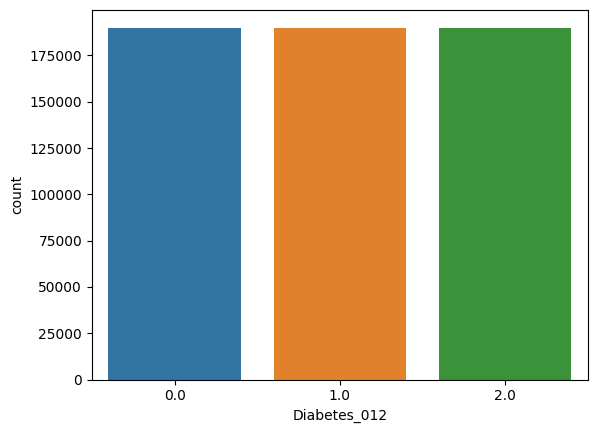

In [ ]:
sns.countplot(data,x = 'Diabetes_012')

<Axes: xlabel='Diabetes_012', ylabel='count'>

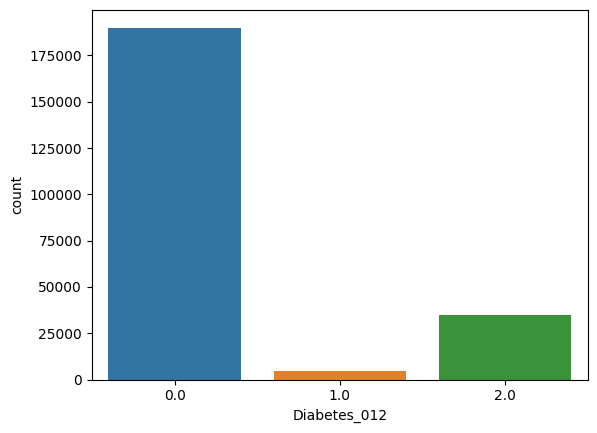

In [ ]:
sns.countplot(data_ros,x = 'Diabetes_012')

As we can see from the previos countplot graph if we remove the duplicated data points we obtain the original imbalanced data which is not useful. Hence we are getting a higher accuracy for ROS data rather than the SMOTE data since the model trained with the ROS data is Overfitted



---



---



---


**Model Training**

1. Using SMOTE data

Accuray for the model using SMOTE Data:  0.9206549648524646




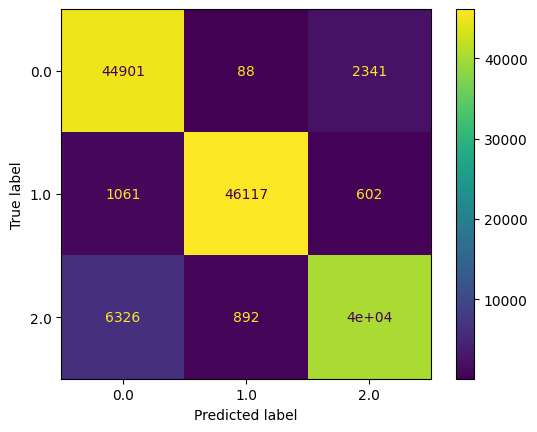

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay
x_train,x_test,y_train,y_test = train_test_split(x_sm,y_sm,test_size = 0.25, random_state= 42)
rfc = RandomForestClassifier()

rfc.fit(x_train,y_train)
y_pred = rfc.predict(x_test)
print('Accuray for the model using SMOTE Data: ', accuracy_score(y_test,y_pred))
print('\n')
cm = confusion_matrix(y_test,y_pred,labels = rfc.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm , display_labels = rfc.classes_)
disp.plot()
plt.show()

2. Using RandomOverSampler Data

Accuracy for the model using RandomOverSampler Data:  0.9611428270763727




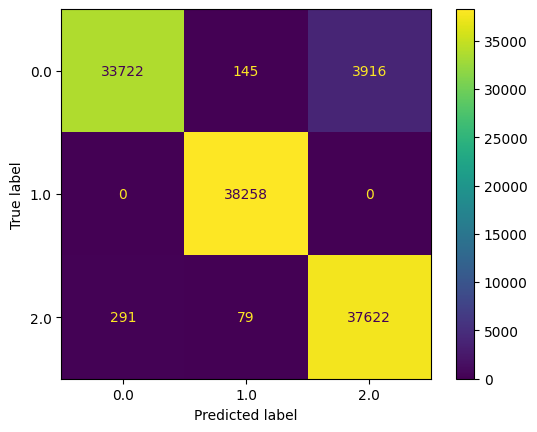

In [ ]:
x_train,x_test,y_train,y_test = train_test_split(x_ros,y_ros, test_size = 0.2, random_state = 42)
rfc_ros = RandomForestClassifier()
rfc_ros.fit(x_train,y_train)
y_pred = rfc_ros.predict(x_test)
print('Accuracy for the model using RandomOverSampler Data: ',accuracy_score(y_test,y_pred))
print('\n')
cm = confusion_matrix (y_test,y_pred, labels = rfc_ros.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = rfc_ros.classes_)
disp.plot()
plt.show()

The model using RandomOverSampler Data is overfitted therefore we will be moving forward using the SMOTE Data



---



---

Distribution Graph for all the features

[]

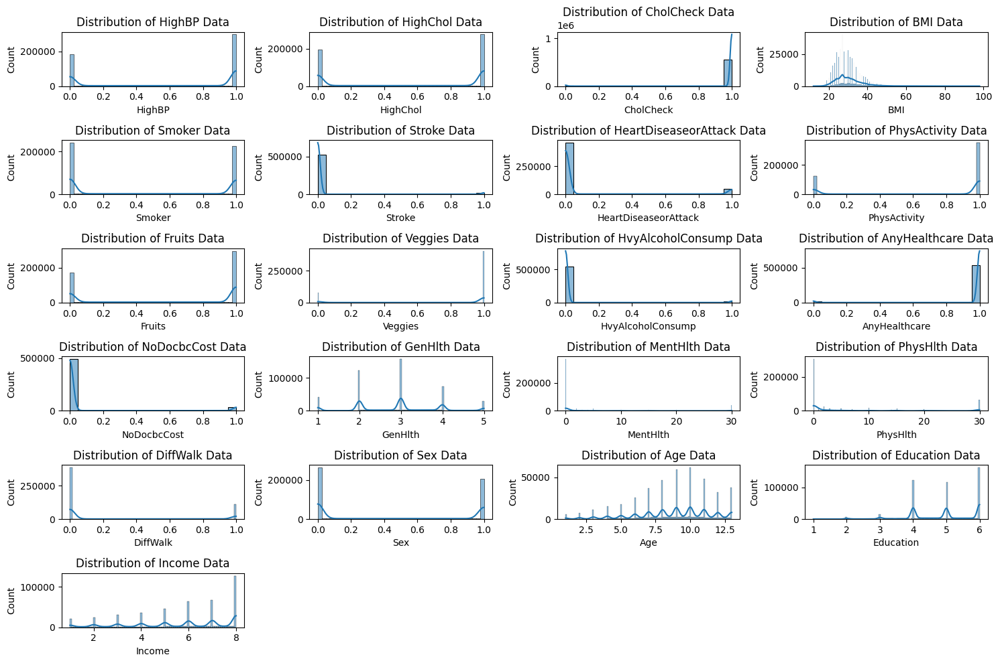

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(15,10))
i = 1
for col in x_sm.columns :
  plt.subplot(6,4,i)
  plt.title(f"Distribution of {col} Data")
  sns.histplot(data[col],kde=True)
  i = i + 1
plt.tight_layout()
plt.plot()

Performing Standardization technique on the data

1. Using StandardScaler

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_std = scaler.fit_transform(x_sm)
x_std = pd.DataFrame(x_std)

In [ ]:
x_std.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,0.865087,0.925100,0.152798,1.378112,1.104053,-0.268346,-0.439084,-1.637160,-1.345689,0.563139,...,0.237940,-0.365593,2.031456,1.643672,0.873792,1.801331,-0.960389,0.079278,-0.883329,-1.189885
1,-1.301588,-1.233057,-7.084475,-0.740287,1.104053,-0.268346,-0.439084,0.709067,-1.345689,-2.082898,...,-4.954044,3.268107,0.089047,-0.480468,-0.596659,-0.627419,-0.960389,-0.648100,1.150359,-2.123497
2,0.865087,0.925100,0.152798,-0.316607,-1.040774,-0.268346,-0.439084,-1.637160,0.858153,-2.082898,...,0.237940,3.268107,2.031456,3.059766,2.344242,1.801331,-0.960389,0.079278,-0.883329,1.144147
3,0.865087,-1.233057,0.152798,-0.457834,-1.040774,-0.268346,-0.439084,0.709067,0.858153,0.563139,...,0.237940,-0.365593,-0.882158,-0.480468,-0.596659,-0.627419,-0.960389,0.806656,-1.900172,0.210534
4,0.865087,0.925100,0.152798,-0.881514,-1.040774,-0.268346,-0.439084,0.709067,0.858153,0.563139,...,0.237940,-0.365593,-0.882158,-0.126445,-0.596659,-0.627419,-0.960389,0.806656,0.133515,-0.723078


In [ ]:
x_std.columns = columns

Checking if there is any change in the distribution graph of the features after using Standardization Technique

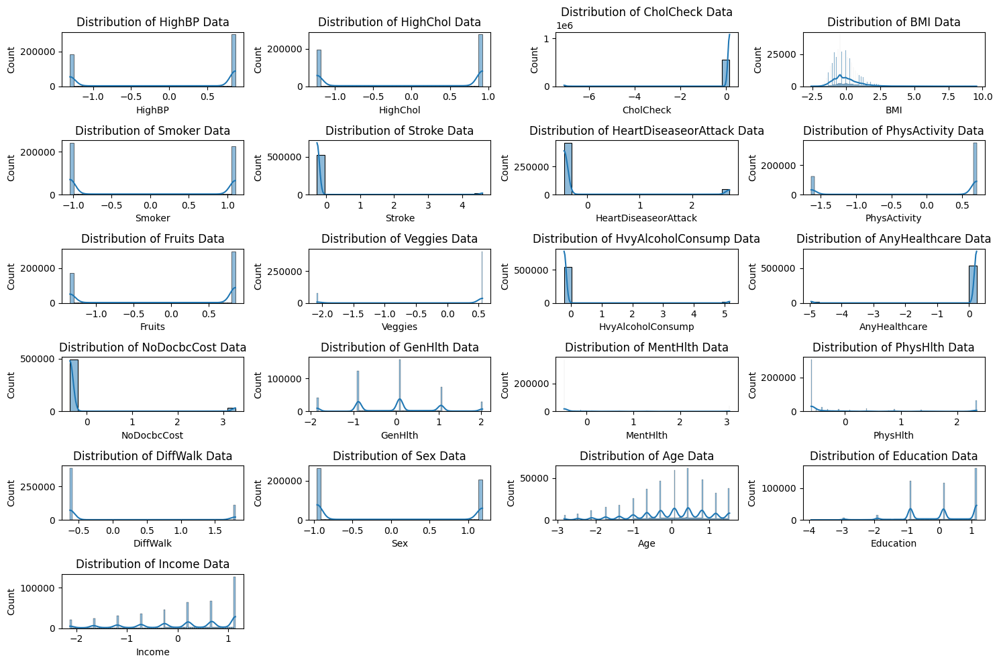

In [ ]:
i = 1
plt.figure(figsize=(15,10))
for col in columns :
  plt.subplot(6,4,i)
  plt.title(f'Distribution of {col} Data')
  sns.histplot(x_std[col],kde = True)
  i = i+1
plt.tight_layout()
plt.show()

2. Using MinMaxScaler

In [ ]:
from sklearn.preprocessing import MinMaxScaler
minmax = MinMaxScaler()
x_minmax = minmax.fit_transform(x_train)
x_minmax = pd.DataFrame(x_minmax)
x_minmax.columns = columns

Distribution Graph after using MinMaxScaler

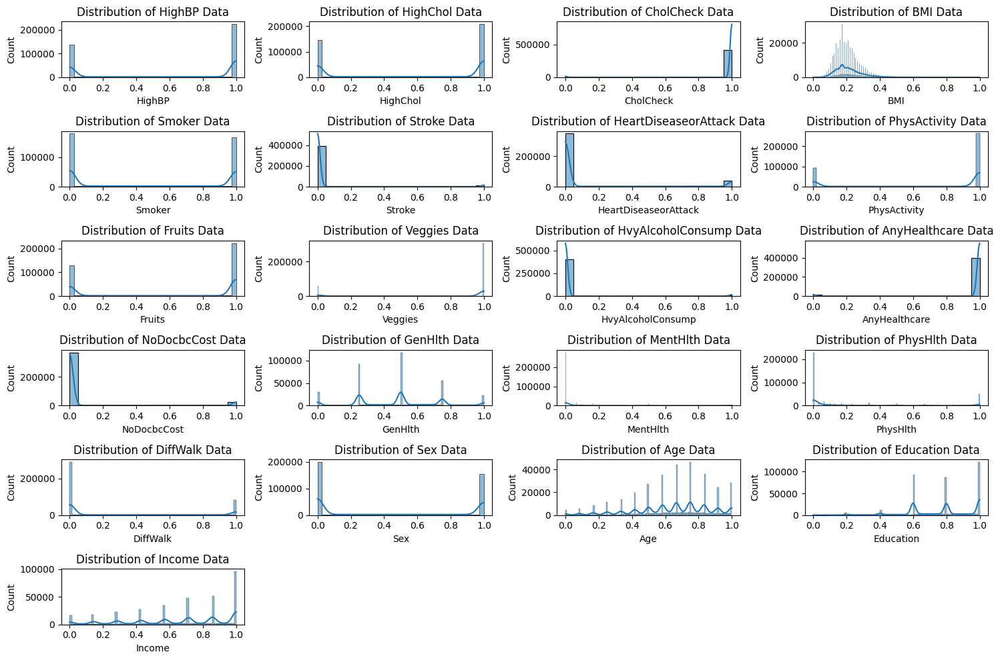

In [ ]:
i = 1
plt.figure(figsize = (15,10))
for col in columns :
  plt.subplot(6,4,i)
  plt.title(f'Distribution of {col} Data')
  sns.histplot(x_minmax[col],kde = True)
  i = i+1
plt.tight_layout()
plt.show()

In [ ]:
len(y_sm)

570165

In [ ]:
x.head()

,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0
1,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0
2,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0
3,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,...,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0
4,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,...,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0


**FEATURE SELECTION**
1. Plotting a Heatmap to check the correlation between the features

In [ ]:
import plotly.express as px
fig = px.imshow(x_ros.corr())
fig.show()

In [ ]:
x_ros.corr()

,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
HighBP,1.000000,0.270305,0.100817,0.189422,0.063346,0.108217,0.177771,-0.100517,-0.023138,-0.048796,...,0.046867,0.000401,0.258741,0.036660,0.136350,0.195511,0.032205,0.294472,-0.104266,-0.130880
HighChol,0.270305,1.000000,0.081219,0.072169,0.084383,0.083995,0.156215,-0.060874,-0.034499,-0.036509,...,0.029822,0.017934,0.187129,0.070829,0.119212,0.131274,0.010670,0.203880,-0.054901,-0.073600
CholCheck,0.100817,0.081219,1.000000,0.042876,-0.003687,0.013753,0.034700,-0.006696,0.020173,0.013266,...,0.108089,-0.054787,0.056299,-0.012061,0.033315,0.039379,-0.015748,0.100908,-0.013203,0.005299
BMI,0.189422,0.072169,0.042876,1.000000,-0.005064,-0.001980,0.025151,-0.147309,-0.075450,-0.052454,...,-0.019217,0.048684,0.211730,0.089318,0.121865,0.202395,-0.008962,-0.098804,-0.070138,-0.076628
Smoker,0.063346,0.084383,-0.003687,-0.005064,1.000000,0.061419,0.115659,-0.053221,-0.071075,-0.010193,...,-0.008450,0.028253,0.124700,0.081721,0.103542,0.111037,0.116425,0.076129,-0.115359,-0.080118
Stroke,0.108217,0.083995,0.013753,-0.001980,0.061419,1.000000,0.202432,-0.054710,-0.005869,-0.038432,...,0.007449,0.039324,0.169248,0.068129,0.146051,0.161670,0.000927,0.107124,-0.065014,-0.119880
HeartDiseaseorAttack,0.177771,0.156215,0.034700,0.025151,0.115659,0.202432,1.000000,-0.073041,-0.010236,-0.019367,...,0.023403,0.026665,0.242499,0.064557,0.175327,0.206959,0.099294,0.206128,-0.076656,-0.121500
PhysActivity,-0.100517,-0.060874,-0.006696,-0.147309,-0.053221,-0.054710,-0.073041,1.000000,0.127454,0.133853,...,0.031131,-0.051767,-0.232964,-0.121380,-0.216174,-0.246216,0.044343,-0.068314,0.157338,0.160730
Fruits,-0.023138,-0.034499,0.020173,-0.075450,-0.071075,-0.005869,-0.010236,0.127454,1.000000,0.244584,...,0.032133,-0.043227,-0.075174,-0.060662,-0.043943,-0.042134,-0.076174,0.082200,0.087490,0.060465
Veggies,-0.048796,-0.036509,0.013266,-0.052454,-0.010193,-0.038432,-0.019367,0.133853,0.244584,1.000000,...,0.020531,-0.027880,-0.097710,-0.056865,-0.063806,-0.069832,-0.042970,0.006230,0.139143,0.133369


2. Plotting the Information Graph

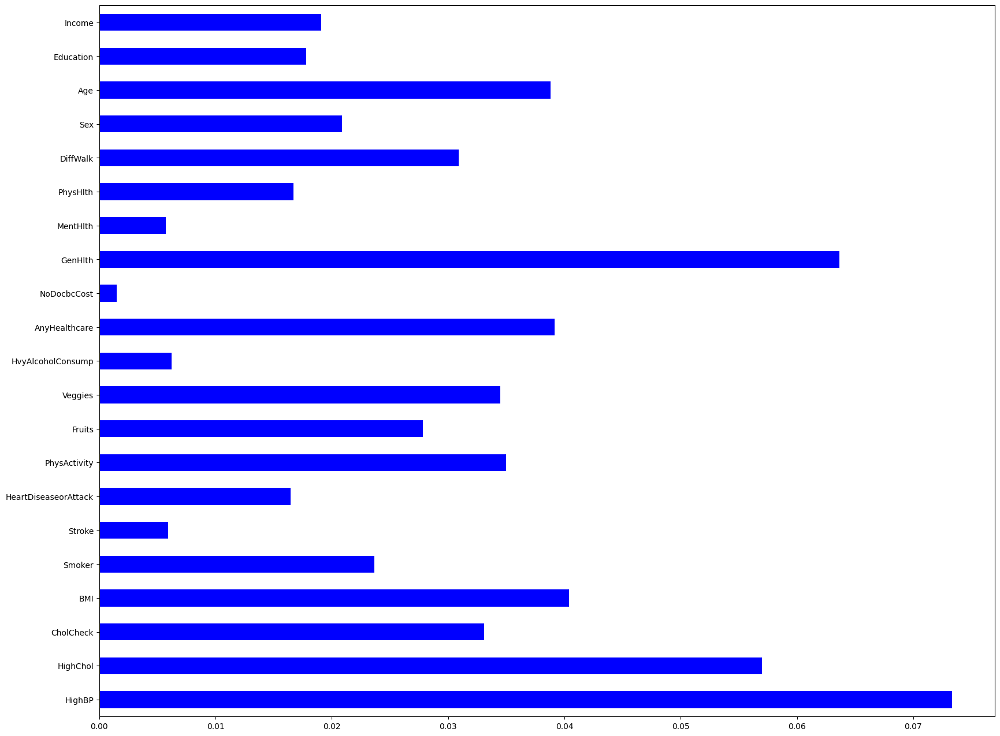

In [ ]:
from sklearn.feature_selection import mutual_info_classif
import matplotlib.pyplot as plt
%matplotlib inline
info = mutual_info_classif(x_train,y_train)
feature_info = pd.Series(info,x_train.columns[0:len(x_train.columns)])
feature_info.plot(kind='barh', color='blue',figsize=(20,16))
plt.show()

The above graph is an information gain graph which helps us undertsand which feature contributes more towards the final outcome

The features with information gain less than 0.02 are being dropped.

In [ ]:
from sklearn.model_selection import train_test_split
x_sm.drop(['MentHlth','NoDocbcCost','HvyAlcoholConsump','Stroke','PhysHlth','HeartDiseaseorAttack'],axis = 1 , inplace = True)
x_train,x_test,y_train,y_test = train_test_split(x_sm,y_sm,test_size = 0.2 , random_state = 42)

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
rfc.fit(x_train,y_train)
print('Accuracy after performing Feature Selection: ', accuracy_score(y_test,rfc.predict(x_test)))

Accuracy after performing Feature Selection:  0.9051765716941587


After removing 5 features there was a drop of only 1.5 % in the accuracy of the model.

3. Checking if any feature has a constant value or a feature has 90% of constant data.

For eg. a feature which has only 1 as its value or a feature which contains 90% of the data as 1 and remaining data as 0.

Such features do not contribute much in predicting the target value.

In [ ]:
from sklearn.feature_selection import VarianceThreshold
sel = VarianceThreshold()
sel.fit(x_train)
sum(sel.get_support())

21

In [ ]:
sel = VarianceThreshold(threshold = 0.01)
sel.fit(x_train)
sum(sel.get_support())

21

In [ ]:
len(x_train)

427623

In [ ]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
sfs = SequentialFeatureSelector(rfc, n_features_to_select=12, direction = 'forward',n_jobs = -1)
sfs.fit(x_train,y_train)
sfs.get_params

4. Performing PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 10)

x_train_pca = pca.fit_transform(x_train)
x_test_pca = pca.fit_transform(x_test)

In [ ]:
rfc = RandomForestClassifier()
rfc.fit(x_train_pca,y_train)
print('Accuracy after performing PCA and reducing the number of features to 10 : ', accuracy_score(y_test,rfc.predict(x_test_pca)))

Accuracy after performing PCA and reducing the number of features to 10 :  0.8825164645321968


The accuracy of the model is reduced to 88% when the features are reduced to 10 using PCA.

Performing KFOLD Clross Validation to know how the model actuallty performs when there are different combination of data for training and testing

In [ ]:
from sklearn.model_selection import KFold, cross_val_score
rfc = RandomForestClassifier()
kfold = KFold(n_splits = 5)

scores = cross_val_score(rfc, x_train,y_train,cv = kfold)

In [ ]:
scores

array([0.89783726, 0.89790303, 0.89680574, 0.89886655, 0.89989696])

In [ ]:
scores.mean()

0.8982619083588096

With number of splits taken as 5 the the mean performance of the model comes out to be 89.82%



---



---

Using Pipeline to build a proper sequence of steps :
Step 1: Standardization
Step 2 : Model Training

In [ ]:
# standardizing the data

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

steps = [('scaler', StandardScaler()),
         ('rfc', RandomForestClassifier())]

pipeline = Pipeline(steps)

pipeline.fit(x_train,y_train)

print(accuracy_score(y_test,pipeline.predict(x_test)))

0.9046065612585831


Finding Hyperparameters for RandomForestClassifier for the given dataset.

In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid = {
    'n_estimators' : [50,75,100,125],
    'criterion' : ['gini','entropy','log_loss'],
    'max_features' : ['sqrt','log2'],
    'n_jobs' : [-1],
    'class_weight' : ['balanced','balanced_subsample'],}


rfc_gs = GridSearchCV(RandomForestClassifier(),param_grid,n_jobs=-1, scoring='roc_auc')
rfc_gs.fit(x_train,y_train)
print('Best Parameters : ', rfc_gs.best_params_)

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:952: UserWarning:

One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan]



Best Parameters :  {'class_weight': 'balanced', 'criterion': 'gini', 'max_features': 'sqrt', 'n_estimators': 50, 'n_jobs': -1}


In [ ]:
rfc = RandomForestClassifier(class_weight = 'balanced', criterion = 'gini', max_features = 'sqrt', n_estimators=50, n_jobs = -1)
rfc.fit(x_train,y_train)
print(accuracy_score(y_test,rfc.predict(x_test)))

0.9022212868204817


Using Different Model to check how the perform on the given dataset.

1. Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression

ls = LogisticRegression(max_iter = 1000)
ls.fit(x_train,y_train)
print(accuracy_score(y_test,ls.predict(x_test)))

0.5157454421088632


As we can see Logistic Regression performs very poorly on the given dataset. From this we can infer that the dataset is not linearly seperable.

In order to make it linearly seperable we need to perform different methods.

2. Decision Tree Classifier

In [ ]:
from sklearn.tree import DecisionTreeClassifier

tree = DecisionTreeClassifier()

tree.fit(x_train,y_train)
print(accuracy_score(y_test,tree.predict(x_test)))

0.8436066752606701


3 KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
print(accuracy_score(y_test,knn.predict(x_test)))

0.8501494296417897


In [ ]:
data_group = data.groupby('Diabetes_012', axis = 0 )
data_0 = data_group.get_group(0)
data_1 = data_group.get_group(1)
data_2 = data_group.get_group(2)


In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn. metrics import accuracy_score, roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay


In [ ]:
from sklearn.preprocessing import LabelEncoder

Scenario 1: Taking only class 0 and 1.

1. Random Forest Classifier 


Accuracy :  0.9872273815474468





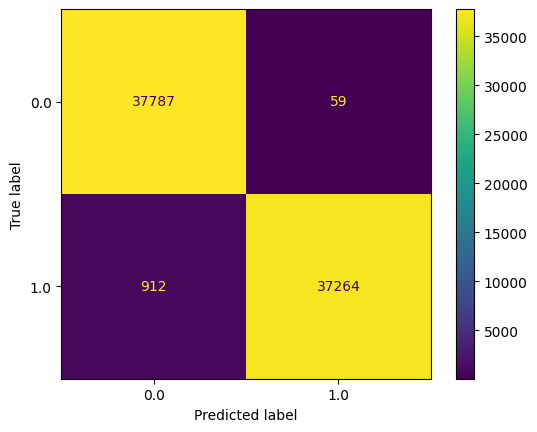




2. Decision Tree Classifier 


Accuracy :  0.9707584646549683





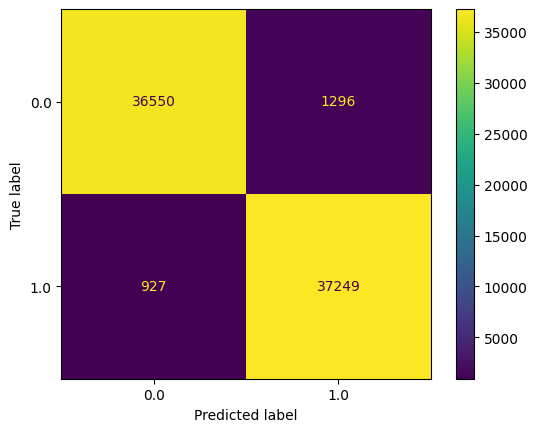




2. K-Nearest Neighbor 


Accuracy :  0.896582568203941





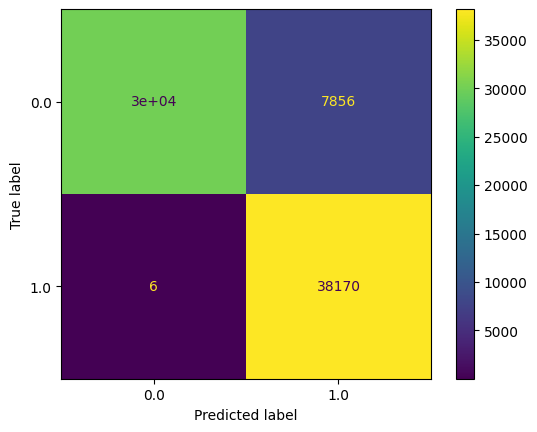

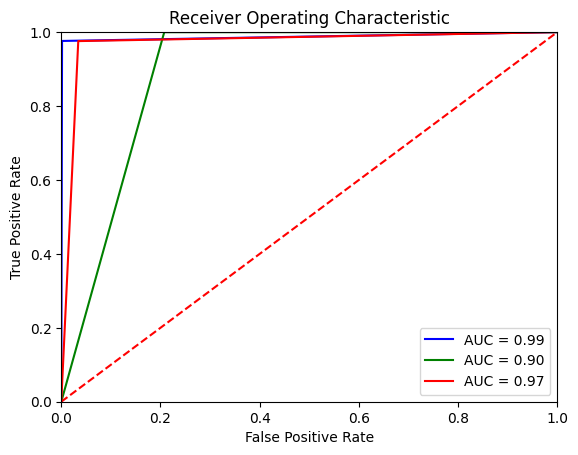

In [ ]:
dataset = pd.concat([data_0,data_1], axis = 0)
# shuffling the data
dataset = dataset.sample(frac = 1)
from sklearn.metrics import roc_curve, auc

x = dataset.drop('Diabetes_012',axis = 1)
y = dataset['Diabetes_012']

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size= 0.2)

rfc = RandomForestClassifier()
rfc.fit(x_train,y_train)
y_pred = rfc.predict(x_test)
print('1. Random Forest Classifier \n\n')
print('Accuracy : ',accuracy_score(y_test,y_pred))
print('\n\n')

cm = confusion_matrix(y_test,y_pred,labels= rfc.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = rfc.classes_)
disp.plot()
plt.show()

fpr,tpr,threshold = roc_curve(y_test,y_pred)
roc_auc = auc(fpr,tpr)


tree = DecisionTreeClassifier()
tree.fit(x_train,y_train)
y_pred = tree.predict(x_test)
print('\n\n')
print('2. Decision Tree Classifier \n\n')
print('Accuracy : ',accuracy_score(y_test,y_pred))
print('\n\n')
cm = confusion_matrix(y_test,y_pred,labels= tree.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = tree.classes_)
disp.plot()
plt.show()
fpr_tree,tpr_tree,threshold = roc_curve(y_test,y_pred)
roc_auc_tree = auc(fpr_tree,tpr_tree)


from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
y_pred = knn.predict(x_test)
print('\n\n')
print('2. K-Nearest Neighbor \n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')


cm = confusion_matrix(y_test,y_pred,labels= knn.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = knn.classes_)
disp.plot()
plt.show()
print('\n\n')
fpr_knn,tpr_knn,threshold = roc_curve(y_test,y_pred)
roc_auc_knn = auc(fpr_knn,tpr_knn)



plt.show()
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.plot(fpr_knn, tpr_knn, 'g', label = 'AUC = %0.2f' % roc_auc_knn)
plt.plot(fpr_tree, tpr_tree, 'r', label = 'AUC = %0.2f' % roc_auc_tree)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()


Taking only class 0 and 2

1. Random Forest Classifier


Accuracy :  0.9077240798716161





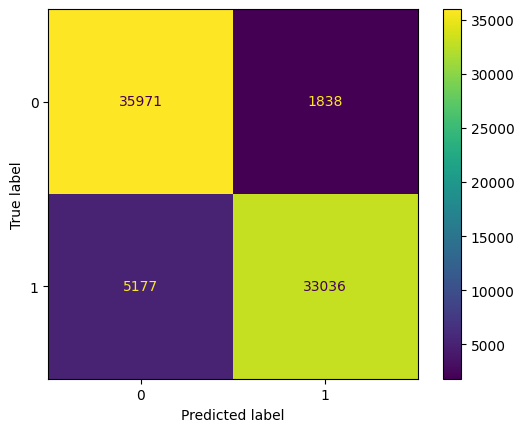




2. Decision Tree Classifier


Accuracy :  0.8627897187656205





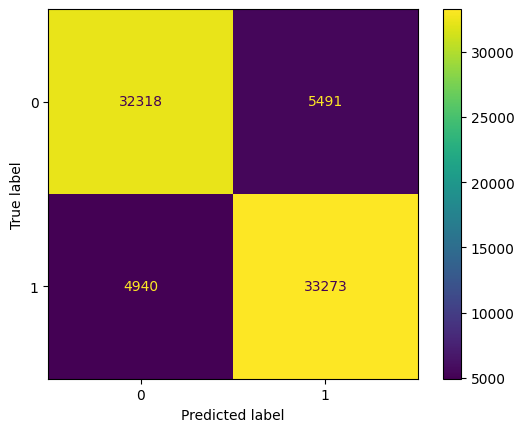




3. K-Nearest Neighbors


Accuracy :  0.8220778195785431





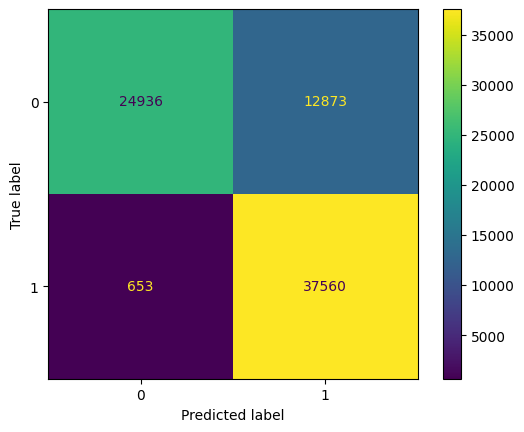

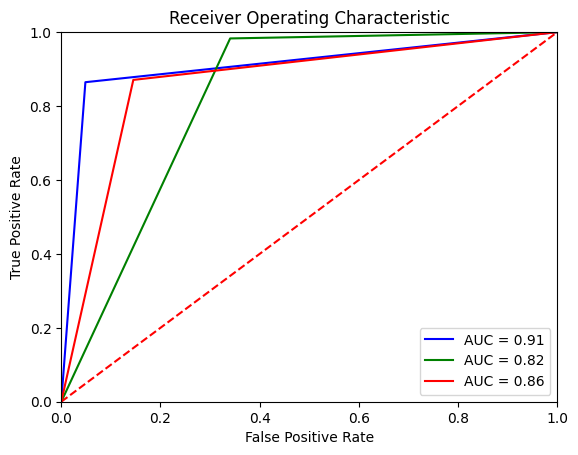

In [ ]:
dataset = pd.concat([data_0,data_2], axis = 0)
# shuffling the data
dataset = dataset.sample(frac = 1)
from sklearn.metrics import roc_curve, auc
encoder = LabelEncoder()
label = encoder.fit_transform(dataset['Diabetes_012'])
dataset['diabetes_012'] = label
dataset.drop('Diabetes_012',axis = 1 , inplace = True)
x = dataset.drop('diabetes_012',axis = 1)
y = dataset['diabetes_012']

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size= 0.2)

rfc = RandomForestClassifier()
rfc.fit(x_train,y_train)
y_pred = rfc.predict(x_test)
print('1. Random Forest Classifier\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')

cm = confusion_matrix(y_test,y_pred,labels= rfc.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = rfc.classes_)
disp.plot()
plt.show()

fpr,tpr,threshold = roc_curve(y_test,y_pred)
roc_auc = auc(fpr,tpr)


tree = DecisionTreeClassifier()
tree.fit(x_train,y_train)
y_pred = tree.predict(x_test)
print('\n\n')
print('2. Decision Tree Classifier\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')
cm = confusion_matrix(y_test,y_pred,labels= tree.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = tree.classes_)
disp.plot()
plt.show()
fpr_tree,tpr_tree,threshold = roc_curve(y_test,y_pred)
roc_auc_tree = auc(fpr_tree,tpr_tree)



from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
y_pred = knn.predict(x_test)
print('\n\n')
print('3. K-Nearest Neighbors\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')

cm = confusion_matrix(y_test,y_pred,labels= knn.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = knn.classes_)
disp.plot()
plt.show()
print('\n\n')
fpr_knn,tpr_knn,threshold = roc_curve(y_test,y_pred)
roc_auc_knn = auc(fpr_knn,tpr_knn)



plt.show()
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.plot(fpr_knn, tpr_knn, 'g', label = 'AUC = %0.2f' % roc_auc_knn)
plt.plot(fpr_tree, tpr_tree, 'r', label = 'AUC = %0.2f' % roc_auc_tree)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()


Taking only class 1 and 2

0.959630107074268


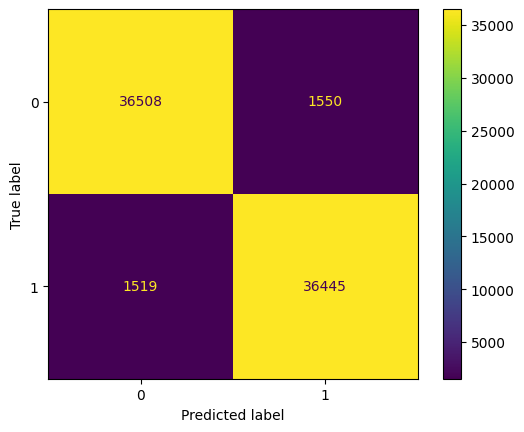

0.9047117939543816


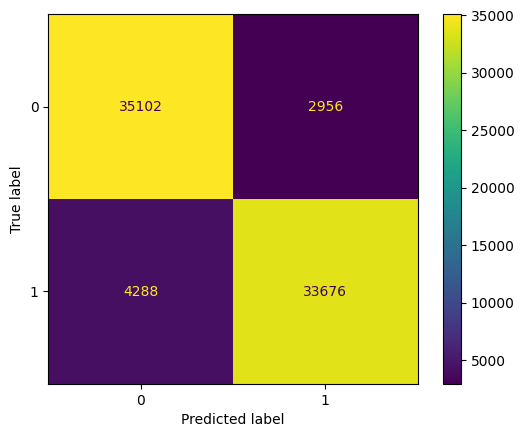

0.9716134803083318


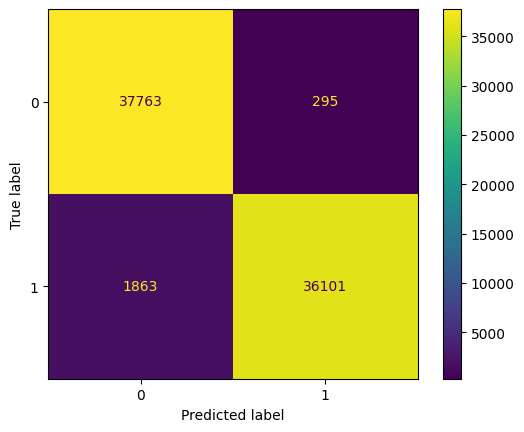

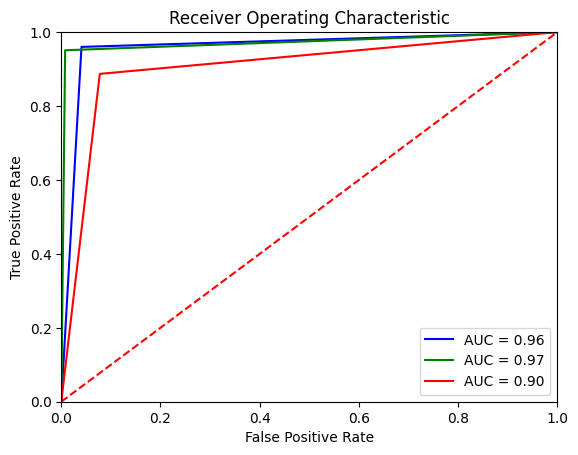

In [ ]:
dataset = pd.concat([data_1,data_2], axis = 0)
dataset = dataset.sample(frac = 1)
from sklearn.metrics import roc_curve, auc
encoder = LabelEncoder()
label = encoder.fit_transform(dataset['Diabetes_012'])
dataset['diabetes_012'] = label
dataset.drop('Diabetes_012',axis = 1 , inplace = True)
x = dataset.drop('diabetes_012',axis = 1)
y = dataset['diabetes_012']

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size= 0.2)

rfc = RandomForestClassifier()
rfc.fit(x_train,y_train)
y_pred = rfc.predict(x_test)
print('1. Random Forest Classifier\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')

cm = confusion_matrix(y_test,y_pred,labels= rfc.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = rfc.classes_)
disp.plot()
plt.show()

fpr,tpr,threshold = roc_curve(y_test,y_pred)
roc_auc = auc(fpr,tpr)


tree = DecisionTreeClassifier()
tree.fit(x_train,y_train)
y_pred = tree.predict(x_test)
print('\n\n')
print('2. Decision Tree Classifier\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')
cm = confusion_matrix(y_test,y_pred,labels= tree.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = tree.classes_)
disp.plot()
plt.show()
fpr_tree,tpr_tree,threshold = roc_curve(y_test,y_pred)
roc_auc_tree = auc(fpr_tree,tpr_tree)



from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
y_pred = knn.predict(x_test)
print('\n\n')
print('3. K-Nearest Neighbors\n\n')
print('Accuracy : ', accuracy_score(y_test,y_pred))
print('\n\n')

cm = confusion_matrix(y_test,y_pred,labels= knn.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = knn.classes_)
disp.plot()
plt.show()
print('\n\n')
fpr_knn,tpr_knn,threshold = roc_curve(y_test,y_pred)
roc_auc_knn = auc(fpr_knn,tpr_knn)



plt.show()
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.plot(fpr_knn, tpr_knn, 'g', label = 'AUC = %0.2f' % roc_auc_knn)
plt.plot(fpr_tree, tpr_tree, 'r', label = 'AUC = %0.2f' % roc_auc_tree)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()
